In [14]:
import numpy as np
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
import folium
from folium.plugins import MarkerCluster

In [2]:
gdf_merimee = gpd.read_parquet("./data/merimee_full.parquet")
gdf_merimee.columns

Index(['reference', 'destination_actuelle_de_l_edifice', 'adresse_forme_index',
       'etablissement_affectataire_de_l_edifice',
       'autre_appellation_de_l_edifice', 'nature_de_la_protection',
       'auteur_de_l_edifice', 'cadastre', 'commune_forme_index', 'copyright',
       'type_de_couverture', 'datation_de_l_edifice',
       'denomination_de_l_edifice',
       'lieu_de_conservation_d_un_element_architectural_deplace',
       'description_de_l_edifice',
       'dimensions_normalisees_des_edicules_uniquement', 'date_de_label',
       'date_de_la_derniere_mise_a_jour', 'date_de_creation_de_la_notice',
       'domaine', 'typologie_du_dossier', 'date_et_typologie_de_la_protection',
       'departement_format_numerique', 'partie_d_elevation_exterieure',
       'source_de_l_energie_utilisee_par_l_edifice',
       'emplacement_forme_et_structure_de_l_escalier',
       'description_de_l_elevation_interieure', 'etat_de_conservation',
       'cadre_de_l_etude', 'genre_du_destinataire', 

In [9]:
len(gdf_merimee_metropole)

46137

In [3]:
outre_mer_codes = ["971", "972", "973", "974", "975", "976"]

gdf_merimee["departement_category"] = np.where(
    gdf_merimee["departement_format_numerique"].isin(outre_mer_codes),
    "outre mer",
    "metropole",
)

In [4]:
gdf_merimee_metropole = gdf_merimee[gdf_merimee["departement_category"] == "metropole"]

In [5]:
def plot_point_map(
    gdf, color_by=None, point_size=2, figsize=(10, 10), cmap="viridis", title=None
):
    fig, ax = plt.subplots(figsize=figsize)

    if color_by:
        gdf.plot(
            ax=ax,
            column=color_by,
            markersize=point_size,
            cmap=cmap,
            legend=gdf[color_by].dtype == "object" or gdf[color_by].nunique() < 20,
        )
        ax.set_title(title or f"Points colored by '{color_by}'")
    else:
        gdf.plot(ax=ax, color="black", markersize=point_size)
        ax.set_title(title or "Point map")

    ax.set_axis_off()
    return fig, ax

(<Figure size 1000x1000 with 1 Axes>,
 <Axes: title={'center': "Points colored by 'nature_de_la_protection'"}>)

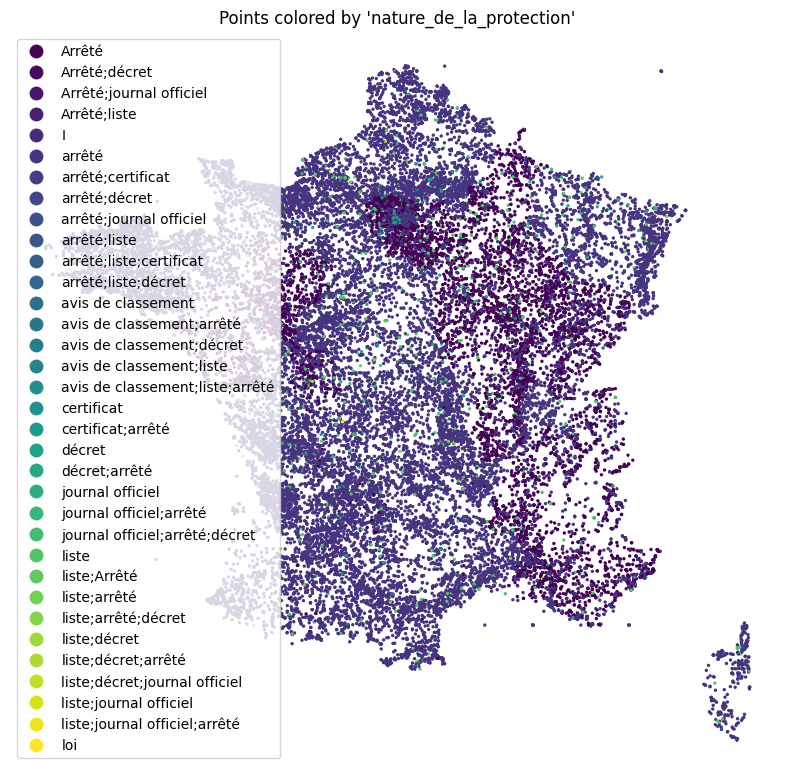

In [12]:
plot_point_map(gdf_merimee_metropole, color_by="nature_de_la_protection")

In [29]:
def plot_folium_clustered_map(
    gdf, geometry_col="coordonnees_au_format_wgs84", popup_col=None
):
    # Make sure it's a geometry series
    gdf = gdf[gdf[geometry_col].notnull()]

    coords = gdf[geometry_col]

    latitudes = coords.y
    longitudes = coords.x

    # Center the map
    m = folium.Map(location=[latitudes.mean(), longitudes.mean()], zoom_start=6)

    marker_cluster = MarkerCluster().add_to(m)

    for idx, row in gdf.iterrows():
        popup = str(row[popup_col]) if popup_col else None
        folium.CircleMarker(
            location=[row[geometry_col].y, row[geometry_col].x],
            radius=2,
            color="blue",
            fill=True,
            fill_opacity=0.6,
            popup=popup,
        ).add_to(marker_cluster)

    return m

In [31]:
plot_folium_clustered_map(gdf_merimee_metropole)